In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

In [2]:
from utils.latticeeasy import *
from utils.label_utils import label_blobs, get_labels
from utils.oscillons import *

In [3]:
from matplotlib import rc
rc('font', **{'family': 'serif', 'serif': ['Computer Modern'], 'size': 10}) # These use the latex font for the pictures :)
# rc('font', **{'serif': ['Computer Modern']})  
rc('text', usetex=True)                       # These use the latex font for the pictures :)
                                                # It's just a pain to set up if you haven't yet.
plt.rcParams['axes.axisbelow'] = True
rc('axes', **{'titlesize': 10})
rc('image', cmap='gist_heat_r')

from mpl_toolkits.axes_grid1 import make_axes_locatable, ImageGrid

# Load data

In [4]:
output_dir = "/media/yangelaxue/23E7CCB1624D2A50/Colliding_Oscillons/CE1"

data = LATTICEEASY(output_dir)
data.__dict__

{'output_dir': '/media/yangelaxue/23E7CCB1624D2A50/Colliding_Oscillons/CE1',
 'alpha': 0.5,
 'beta': 50.0,
 'phi_0': 0.118201,
 'dt_pr': 0.001,
 'dim': 1,
 'domain_width_pr': array([5.]),
 'domain_dimensions': (256,),
 't': array([0.00000000e+00, 1.00099100e+00, 2.00203700e+00, 3.00296500e+00,
        4.00389200e+00, 5.00481900e+00, 6.00574700e+00, 7.00667400e+00,
        8.00760700e+00, 9.00901100e+00, 1.00104160e+01, 1.10118210e+01,
        1.20132260e+01, 1.30146300e+01, 1.40160350e+01, 1.50174400e+01,
        1.60188260e+01, 1.70192760e+01, 1.80197260e+01, 1.90201760e+01,
        2.00206260e+01, 2.10210760e+01, 2.20215260e+01, 2.30219760e+01,
        2.40224270e+01, 2.50228770e+01, 2.60233270e+01, 2.70237770e+01,
        2.80242270e+01, 2.90246770e+01, 3.00251270e+01, 3.10255780e+01,
        3.20260280e+01, 3.30264780e+01, 3.40269280e+01, 3.50273780e+01,
        3.60278280e+01, 3.70282780e+01, 3.80287280e+01, 3.90291790e+01,
        4.00296290e+01, 4.10300790e+01, 4.20305290e+01, 4

In [5]:
timeslices = [i for i in range(0,data.t.size,1)]

phi_list = [load_phi(output_dir,data.domain_dimensions,timeslice) for timeslice in timeslices]
phip_list = [load_phip(output_dir,data.domain_dimensions,timeslice) for timeslice in timeslices]

In [6]:
np.array(phi_list).shape

(862, 256)

In [7]:
x = np.linspace(0, data.domain_width_pr[0], data.domain_dimensions[0])

In [18]:
def animate(i, vals_list):
    l.set_data(x, vals_list[i])
    ax.set_title(f"{i}, {data.t[i]}")

(-4.96862, 4.980043)

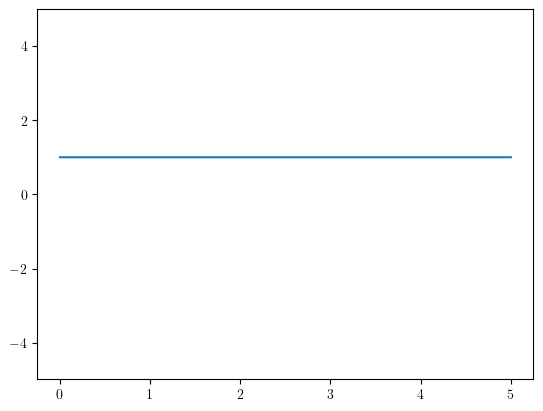

In [19]:
fig, ax = plt.subplots()

l, = ax.plot(x,phi_list[0])
ax.set_ylim(np.min(phi_list), np.max(phi_list))

In [20]:
phi_ani = FuncAnimation(fig, animate, fargs=(phi_list,), frames=data.t.size)

HTML(phi_ani.to_jshtml())

Animation size has reached 20987702 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [21]:
Edens_list = [get_Edens_pr(phi, phip, data.a[timeslices[i]], data.ap[timeslices[i]],
        data.alpha, data.beta, data.phi_0, data.domain_width_pr/data.domain_dimensions
    ) for i, (phi, phip) in enumerate(zip(phi_list,phip_list))]

(5.307985248883132e-05, 2.73991705694009)

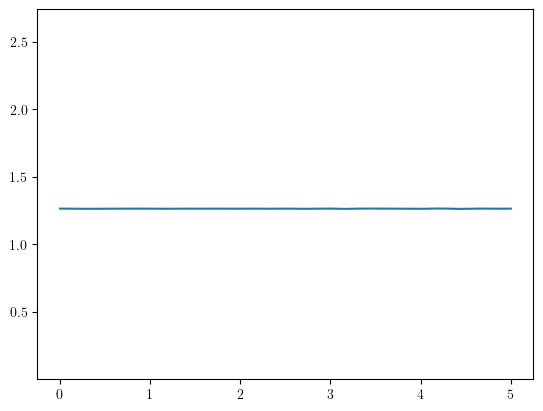

In [22]:
fig, ax = plt.subplots()

l, = ax.plot(x,Edens_list[0])
ax.set_ylim(np.min(Edens_list), np.max(Edens_list))

In [23]:
Edens_ani = FuncAnimation(fig, animate, fargs=(Edens_list,), frames=data.t.size)

HTML(Edens_ani.to_jshtml())

Animation size has reached 20992460 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


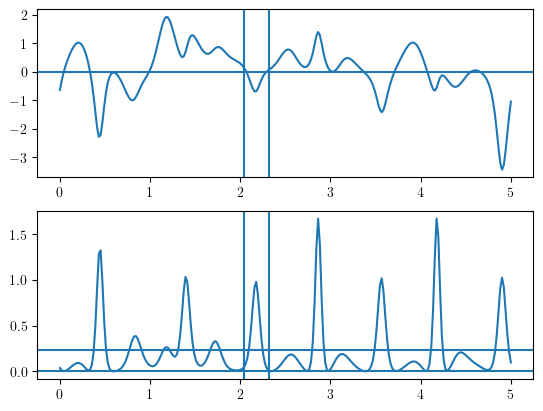

In [36]:
idx = 500

fig, (ax1, ax2) = plt.subplots(2,1, )

ax1.plot(x,phi_list[idx])
ax1.axhline(0)

ax2.plot(x,Edens_list[idx])
ax2.axhline(Edens_list[idx].mean())
ax2.axhline(0)

ax1.axvline(x[104])
ax2.axvline(x[104])
ax1.axvline(x[118])
ax2.axvline(x[118])

plt.show()